# Color Segmentation

## Apply unsupervised learning techniques on satellite images in order to approximate the proportion of forests

This problem is exposed in "Hand's On Machine-learning with Scikit-Learn, Keras & TensorFlow", Aurélien Géron, 2020

In [2]:
import cv2
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import numpy as np

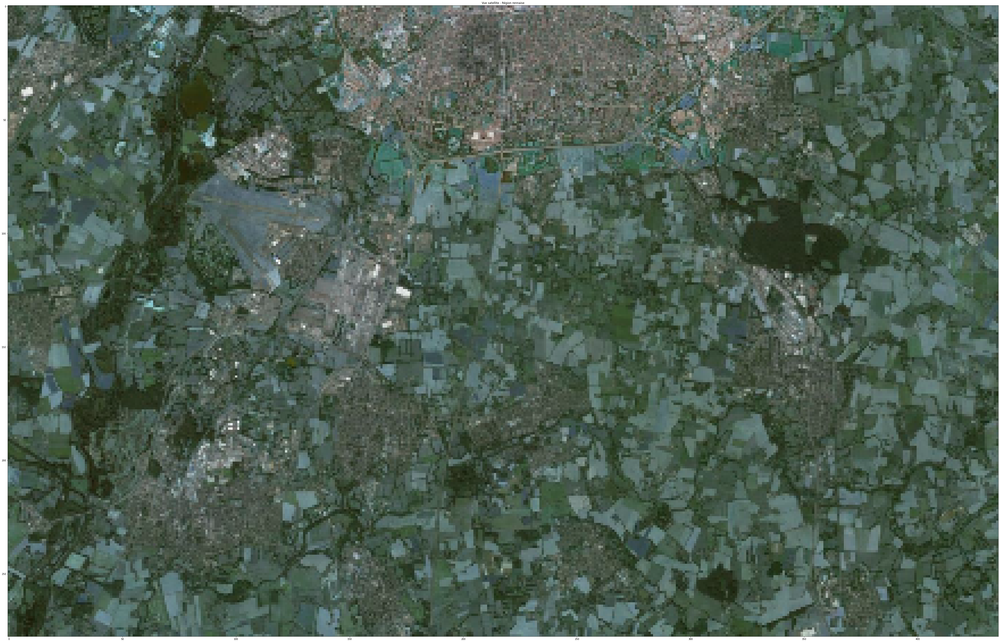

In [3]:
WIDTH_ = 436
HEIGHT = 278
largeur_m = 17380

plt.figure(figsize=(100,50))
img = cv2.imread('satelite image.png')
img = cv2.resize(img, (WIDTH_,HEIGHT))
plt.imshow(img)
plt.title('Vue satellite - Région rennaise')
plt.show()

pixel_m = largeur_m // WIDTH_

## Kmeans clustering

In [4]:
# Compute K mean with different numbers of cluster

X = img.reshape(-1, 3)
nb_clusters = [2, 3, 4, 5, 6]
segmented_imgs = []
for i in range(len(nb_clusters)):
    kmeans = KMeans(n_clusters=nb_clusters[i], random_state=42).fit(X)
    segmented_img = kmeans.cluster_centers_[kmeans.labels_]
    segmented_imgs.append(segmented_img.reshape(img.shape).astype(np.uint8)[:,:,1])

## Visualization

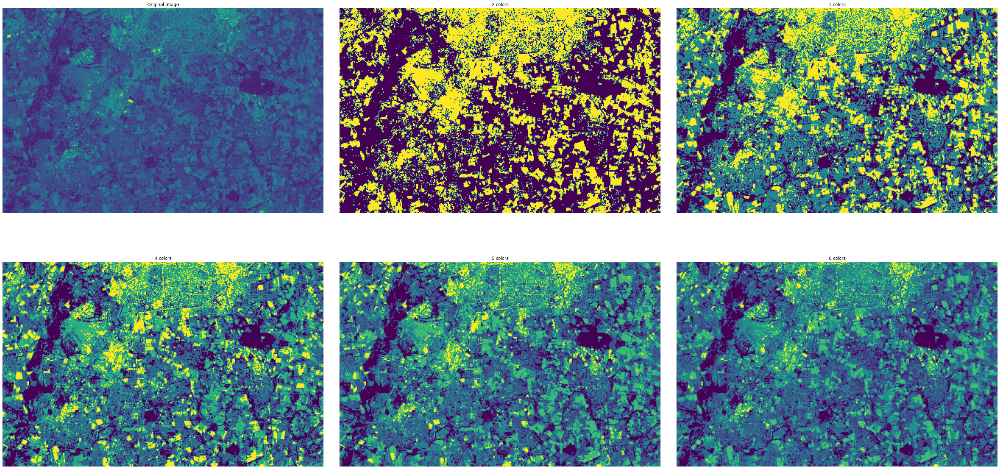

In [5]:
# plot the result

plt.figure(figsize=(50,25))
plt.subplots_adjust(wspace=0.05, hspace=0.1)

plt.subplot(231)
plt.imshow(img[:,:,0])
plt.title("Original image")
plt.axis('off')

for idx, n_clusters in enumerate(nb_clusters):
    plt.subplot(232 + idx)
    plt.imshow(segmented_imgs[idx])
    plt.title("{} colors".format(n_clusters))
    plt.axis('off')

plt.show()

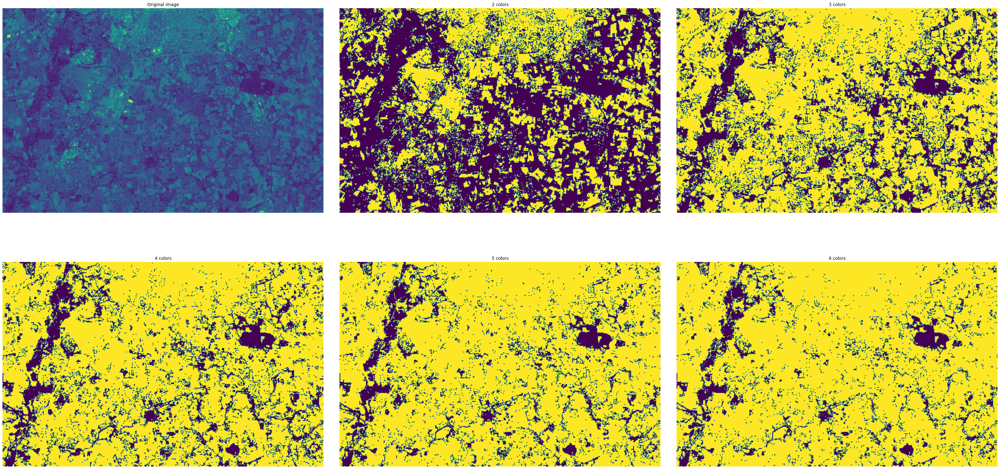

In [6]:
# Only keep forest

plt.figure(figsize=(50,25))
plt.subplots_adjust(wspace=0.05, hspace=0.1)

plt.subplot(231)
plt.imshow(img[:,:,0])
plt.title("Original image")
plt.axis('off')

for idx, n_clusters in enumerate(nb_clusters):
    plt.subplot(232 + idx)
    forest_color = min(segmented_imgs[idx][0])
    j = segmented_imgs[idx] > forest_color
    j = j.astype(int)
    plt.imshow(j)
    plt.title("{} colors".format(n_clusters))
    plt.axis('off')

plt.show()

In [8]:
print("With 6 Color cluster")
foret = np.count_nonzero(segmented_imgs[idx] <= forest_color) * pixel_m
total = HEIGHT * WIDTH_ * pixel_m
print(foret, 'm² of forest which is equivalent to', foret/1e6,'km²')
print(foret / total * 100, '% of forest')

With 6 Color cluster
617292 m² of forest which is equivalent to 0.617292 km²
13.058543990495677 % of forest




## Explore DBSCAN on this problem

In [13]:
from sklearn.cluster import DBSCAN

In [16]:
X = img.reshape(-1, 3)
eps = [0.6, 0.7, 0.8, 0.9]
segmented_imgs = []
for e in eps:
    print("------>   dbscan eps =", e)
    dbscan = DBSCAN(eps = e, min_samples=5).fit(X)
    segmented_img = dbscan.labels_
    segmented_imgs.append(segmented_img.reshape((img.shape[0], img.shape[1], 1)).astype(np.uint8))

------>   dbscan eps = 0.6
------>   dbscan eps = 0.7
------>   dbscan eps = 0.8
------>   dbscan eps = 0.9


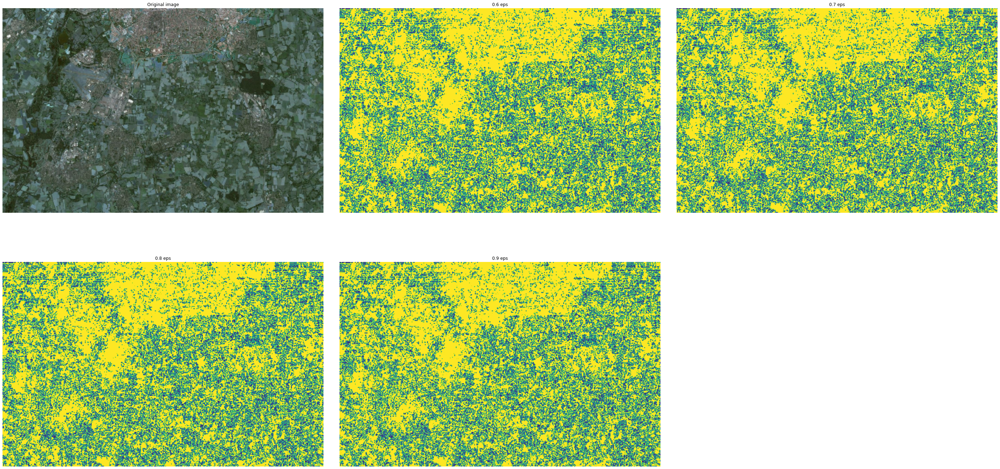

In [17]:
plt.figure(figsize=(50,25))
plt.subplots_adjust(wspace=0.05, hspace=0.1)

plt.subplot(231)
plt.imshow(img)
plt.title("Original image")
plt.axis('off')

for idx, n_clusters in enumerate(eps):
    plt.subplot(232 + idx)
    plt.imshow(segmented_imgs[idx])
    plt.title("{} eps".format(n_clusters))
    plt.axis('off')

plt.show()